In [62]:
import cv2 #manipular imagenes
import numpy as np #operaciones numericas
import matplotlib.pyplot as plt #visualizar imagenes
from IPython.display import Image #mostrar imagenes en jupyter
import os #Para operaciones del sistema operativo
import random #Para operaciones aleatorias

In [98]:
#Definicion de funciones:
def find_blister_contour(img):
    # --- Convertir a escala de grises ---
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # --- Suavizar ---
    blur = cv2.GaussianBlur(gray, (7,7), 0)

    # --- Bordes ---
    edges = cv2.Canny(blur, 50, 150)

    # --- Cerrar huecos para que el contorno sea más sólido ---
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7)) #
    closed = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)

    # --- Buscar contornos ---
    contours, _ = cv2.findContours(closed, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # --- Seleccionar el contorno más grande ---
    blister_contour = max(contours, key=cv2.contourArea)

    return blister_contour

def recortar_blister(img, contour):
    x, y, w, h = cv2.boundingRect(contour)
    blister = img[y:y+h, x:x+w]
    return blister

def nivel_oscuridad(img, centro, radio):
    img_ycrcb = cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)
    y, cr, cb = cv2.split(img_ycrcb)

    # Ecualizar el canal Y
    y_eq = cv2.equalizeHist(y)

    # Unir de nuevo
    img_eq = cv2.merge([y_eq, cr, cb])
    img_eq = cv2.cvtColor(img_eq, cv2.COLOR_YCrCb2BGR)

    # Crear máscara circular
    mask = np.zeros(img_ycrcb.shape, dtype=np.uint8)
    cv2.circle(mask, centro, radio, 255, -1)  # círculo lleno

    # Extraer solo la región circular
    valores = img_ycrcb[mask == 255]

    # Calcular nivel de oscuridad
    # 0 = negro, 255 = blanco
    promedio = valores.mean()

    return promedio

def detectar_cavidades_contornos(blister, min_area=2500, circularity_thresh=(0.8, 1)):
    gray = cv2.cvtColor(blister, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (7,7), 0)
    # Contraste adaptativo CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    gray_blister_clahe = clahe.apply(blur)
    edges = cv2.Canny(gray_blister_clahe, 50, 150)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    closed = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)
    # plt.figure()
    # plt.title("Morfología de Cierre")
    # plt.imshow(closed, cmap='gray')
    # plt.axis('off')  # Ocultar los ejes
    # plt.show()
    # Encontrar contornos
    contours, _ = cv2.findContours(closed, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    img_contours = blister.copy()
    cavidades_props = []
    niveles = []
    cav_blister = []
    for cnt in contours:
        
        area = cv2.contourArea(cnt)
        perimeter = cv2.arcLength(cnt, True)
        if perimeter == 0:
            continue
        circularity = 4*np.pi*(area/(perimeter**2))
        if circularity_thresh[0] <= circularity <= circularity_thresh[1] and area >= min_area:
            # Aproximar centro y radio
            (x,y), radius = cv2.minEnclosingCircle(cnt)
            oscuridad = nivel_oscuridad(blister, (int(x), int(y)), int(radius))
            niveles.append(oscuridad)
            cavidades_props.append({'centro': (int(x), int(y)), 'radio': int(radius), 'area': area})

    level=np.mean(niveles)
    print(f'promedio: {level}')
    for cav,osc in zip(cavidades_props,niveles):
        if osc > level*0.91:
            cav_blister.append(cav)
            # Dibujar contornos
            cv2.circle(img_contours, cav['centro'], cav['radio'], (0,0,255), 3)

    num_blisters = len(cav_blister)
    # print(f"Número de blisters: {num_blisters}")
    print (np.uint8(niveles))
    return img_contours, num_blisters, niveles,cav_blister




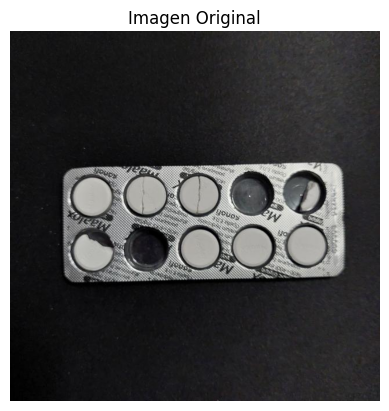

In [80]:
#--- Mostrar imagen original aleatoria ---
#folder_path = "valid/images/" #Carpeta con imagenes de validacion
folder_path = "img_depurado/" #Carpeta con imagenes de validacion
#Seleccionar imagen aleatoria de la carpeta ramdom.choice para elegir un elemento aleatorio de una lista 
# os.listdir para listar los archivos en la carpeta
#imagen = random.choice(os.listdir(folder_path))
imagen="20250312_173454_jpg.rf.d260cc844542c7f0e853c212cc66fcfb.jpg"
img = cv2.imread(os.path.join(folder_path, imagen)) #Leer la imagen seleccionada

#Ver imagen original
plt.figure()
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title("Imagen Original")
plt.axis('off')  # Ocultar los ejes
plt.show()

Procesada imagen: ('20250312_173454_jpg.rf.d260cc844542c7f0e853c212cc66fcfb.jpg', (640, 640, 3))


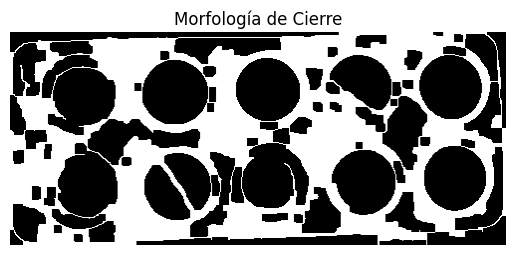

promedio: 184.7576164837499
[184 183 186 184 184]


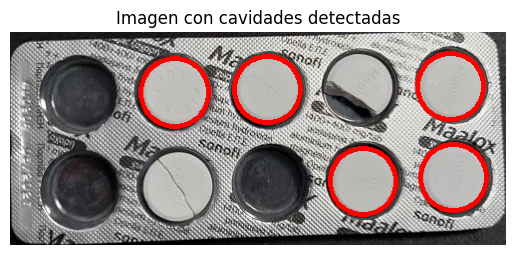

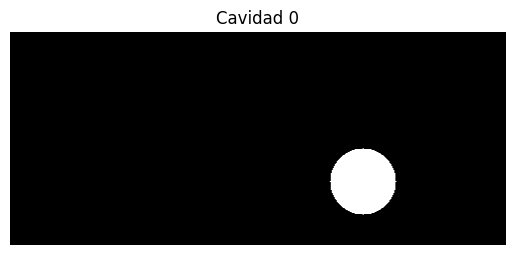

In [85]:
blister_contour = find_blister_contour(img)
img_contour = img.copy()
print(f"Procesada imagen: {imagen, img_contour.shape}")
blister = recortar_blister(img_contour, blister_contour)
img_circles, num_blisters,niveles, cavidades = detectar_cavidades_contornos(blister,min_area=1000, circularity_thresh=(0.8, 1.1))

#Ver imagen final
plt.figure()
plt.imshow(cv2.cvtColor(img_circles, cv2.COLOR_BGR2RGB))
plt.title("Imagen con cavidades detectadas")
plt.axis('off')  # Ocultar los ejes
plt.show()

i = 0  # cavidad que quieras mostrar
mask = np.zeros((blister.shape[0], blister.shape[1]), dtype=np.uint8)
cv2.circle(mask, cavidades[i]['centro'], cavidades[i]['radio'], 255, -1)

plt.figure()
plt.imshow(mask, cmap='gray')
plt.axis('off')
plt.title(f"Cavidad {i}")
plt.show()

In [ ]:
image_folder = "img_depurado/"
for filename in os.listdir(image_folder):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        image_path = os.path.join(image_folder, filename) #ruta completa
        img = cv2.imread(image_path) #cargar imagen
        blister_contour = find_blister_contour(img)
        img_contour = img.copy()
        #cv2.drawContours(img_contour, [blister_contour], -1, (0,255,0), 3)
        print(f"Procesada imagen: {filename, img_contour.shape}")

        blister = recortar_blister(img_contour, blister_contour)
        
        img_circles, blister_ok, niveles,cavidades = detectar_cavidades_contornos(blister,min_area=1000, circularity_thresh=(0.8, 1.1))
      

        plt.imshow(cv2.cvtColor(img_circles, cv2.COLOR_BGR2RGB))
        plt.axis('off')  # Ocultar los ejes
        plt.title(f"Blister OK: {blister_ok}")
        plt.show()
        #cv2.imshow("Blister detectado", img_contour)

In [ ]:
# with open("lable_depurado.txt", "r") as f1, open("label_depurado2.txt", "w") as f2:
#     for line in f1:
#         line = line.strip()
#         if not line:
#             continue

#         nombre, valores = line.split(":")
#         valores = valores.strip("()")
#         a, b = valores.split(",")

#         nuevo = f"({a},{b},{b})"
#         f2.write(f"{nombre}:{nuevo}\n")


In [105]:
def cargar_n_reales(ruta_reales):
    reales = {}
    with open(ruta_reales, "r") as f:
        for line in f:
            line = line.strip()

            # ignorar líneas vacías
            if not line:
                continue

            # ignorar líneas que no tengan ":" 
            if ":" not in line:
                print(f"⚠ Línea inválida ignorada: {line}")
                continue

            try:
                nombre, valores = line.split(":")
                vacias, incompletas,rotas = valores.strip("()").split(",")
                reales[nombre] = int(vacias)+int(incompletas)+int(rotas)
            except Exception as e:
                print(f"⚠ Error procesando línea: {line}\n{e}")
                continue

    return reales

In [113]:
ruta_reales = "label_depurado2.txt"
reales = cargar_n_reales(ruta_reales)

total_cavidades = 10

correctos = 0
procesados = 0




Procesada imagen: ('20250224_153124_jpg.rf.3847578dfd66b817407e466c7874943d.jpg', (640, 640, 3))
promedio: 181.30010449849286
[181 175 181 182 182 183 177 182 182 183]


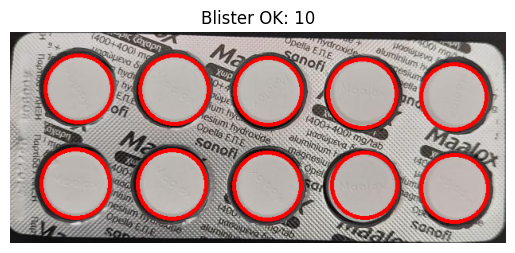


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_153131_jpg.rf.9c402a72bffe6d996dba78c04995142b.jpg', (640, 640, 3))
promedio: 189.63051183231036
[189 189 187 187 186 189 194 189 191 191]


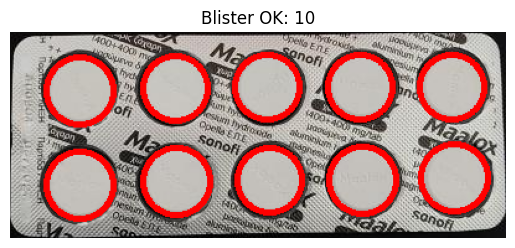


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_153224_jpg.rf.0fa68392afccda00f29f736c35fd06b7.jpg', (640, 640, 3))
promedio: 160.9568722101022
[162 159 160 154 159 165 161 164 158 163]


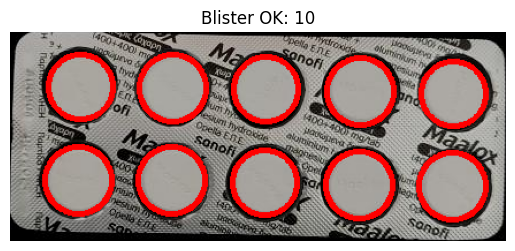


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_153235_jpg.rf.122631a9a7650595c374f26234d17b6b.jpg', (640, 640, 3))
promedio: 196.56549865504968
[196 195 191 193 198 197 199 196 200 196]


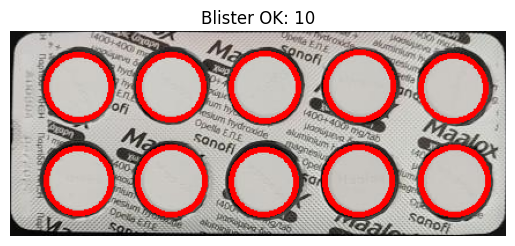


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_153255_jpg.rf.3c06ba6e010a146fe14a3a5508ab60f3.jpg', (640, 640, 3))
promedio: 192.3905009754497
[189 193 190 190 193 194 190 192 195 193]


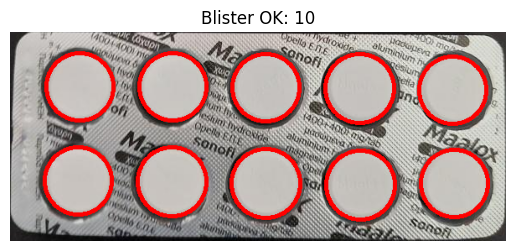


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_153309_jpg.rf.e9ce0a9dbd806d0c5fce17e530921049.jpg', (640, 640, 3))
promedio: 185.99759552112016
[183 186 187 183 185 187 187 189 185 184]


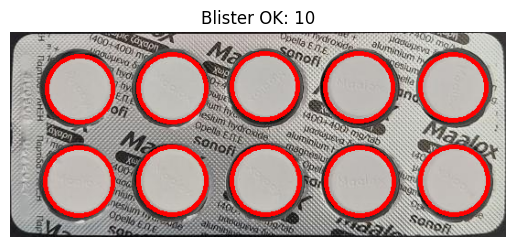


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_153536_jpg.rf.b90fee575e0bd8430c0c8fc9f5dade0e.jpg', (640, 640, 3))
promedio: 170.66194732447286
[173 170 171 166 166 169 174 175 169 168]


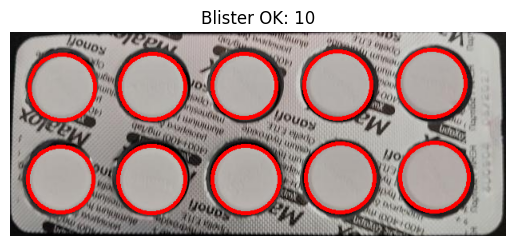


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_153550_jpg.rf.173fabce4a93e19216e722feba55baea.jpg', (640, 640, 3))
promedio: 191.01315784111753
[188 189 191 186 191 193 192 193 190 191]


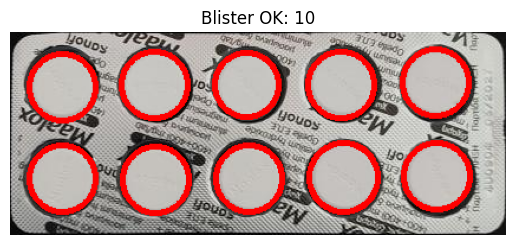


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_153552_jpg.rf.30ae352663aca0cbe82aaf29bc79ac9a.jpg', (640, 640, 3))
promedio: 189.9386460654344
[188 187 187 188 189 190 193 194 188 190]


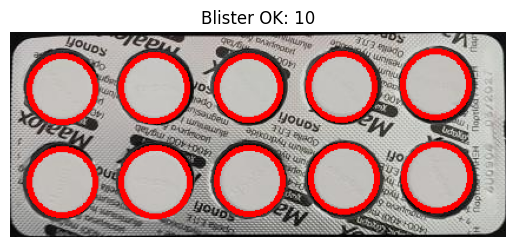


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_153554_jpg.rf.e37fba83d295614302716f5a6331f32d.jpg', (640, 640, 3))
promedio: 190.5627395026498
[188 192 190 188 189 189 192 193 189 189]


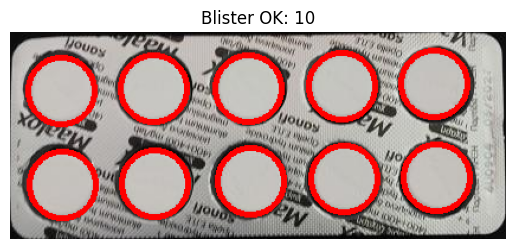


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_153556_jpg.rf.992185cb04c58d164a9d4023adf5cc6e.jpg', (640, 640, 3))
promedio: 195.97558092132084
[195 198 198 195 193 195 197 196 194 194]


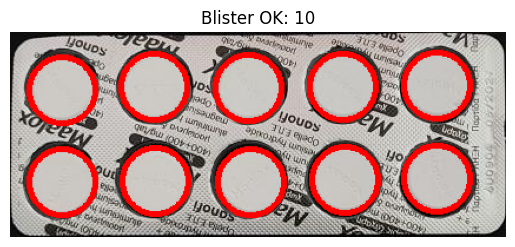


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_153602_jpg.rf.482dc789a565f0abe770156c5a574a6d.jpg', (640, 640, 3))
promedio: 195.41594929567665
[193 198 194 189 197 194 198 195 195 195]


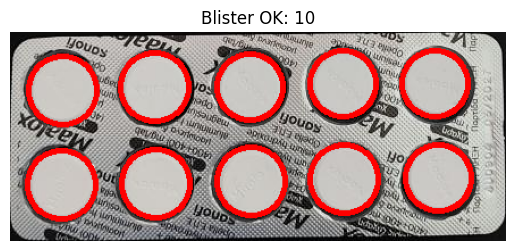


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_153609_jpg.rf.7e75454f40fea3a01319db8ab18f9274.jpg', (640, 640, 3))
promedio: 177.23713478087512
[175 177 179 175 171 182 178 173 180 178]


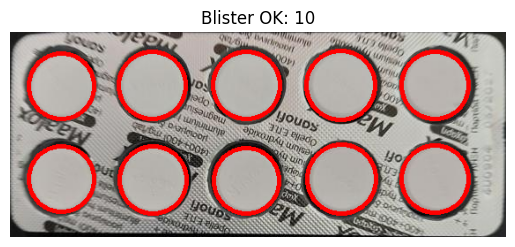


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_153840_jpg.rf.6b49a945278ed4010761d21d67165d46.jpg', (640, 640, 3))
promedio: 221.11318205794856
[230 228 220 229 223 214 214 217 212 218]


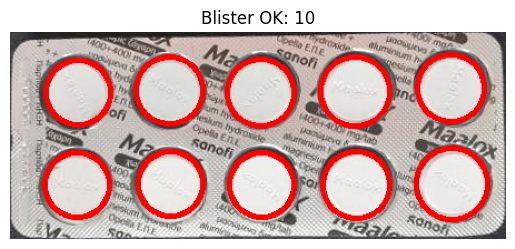


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_153904_jpg.rf.5275cb0dbc1085b0167e86e846ae4f3c.jpg', (640, 640, 3))
promedio: 206.53255299324482
[210 208 208 208 202 205 204 205]


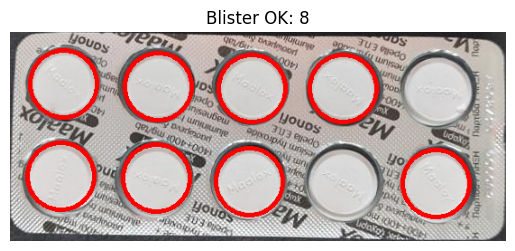


Cavidades vacías reales: 0, detectadas: 2
Detección incorrecta ❌

Procesada imagen: ('20250224_155804_jpg.rf.78db2607faf7d1e3436ca30c0e8522b0.jpg', (640, 640, 3))
promedio: 174.86965789199402
[172 172 177 176 178 171 174 170 176 177]


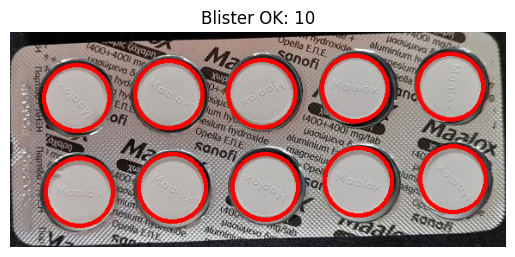


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_155804_jpg.rf.811657b022b706b29cd562a558ba1503.jpg', (640, 640, 3))
promedio: 193.46819814770984
[198 198 195 192 191 195 192 188 189 192]


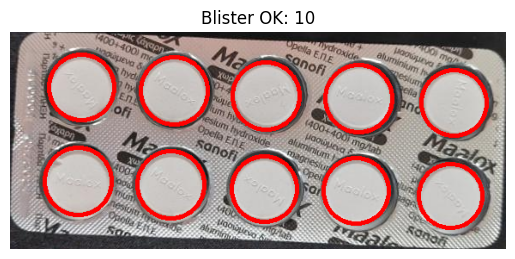


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_162133_jpg.rf.99df02cca8fc00e8728cf19dd9801c93.jpg', (640, 640, 3))
promedio: 175.72756766193098
[170 169 174 172 175 180 179 179 178 175]


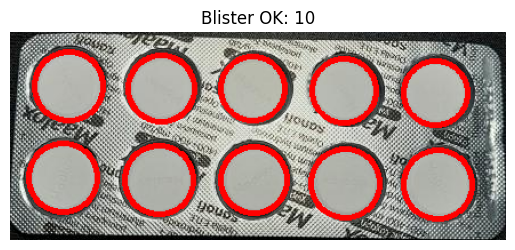


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_162139_jpg.rf.2c38053e427bc40ee19e01342f224532.jpg', (640, 640, 3))
promedio: 190.9371959409913
[192 192 194 196 190 189 187 191 187 186]


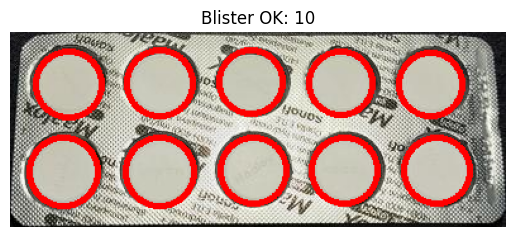


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_162154_jpg.rf.fed8f970380e36784e3e5b4adf7de2c3.jpg', (640, 640, 3))
promedio: 187.27275781609586
[182 184 182 183 179 191 195 195 191 184]


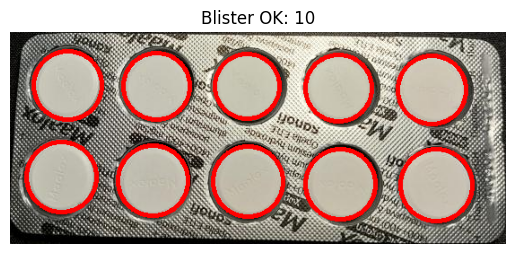


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_162158_jpg.rf.433034f16d7b7c2b373a1436e81c4b7a.jpg', (640, 640, 3))
promedio: 178.1021336539125
[180 175 177 173 170 182 182 185 177 175]


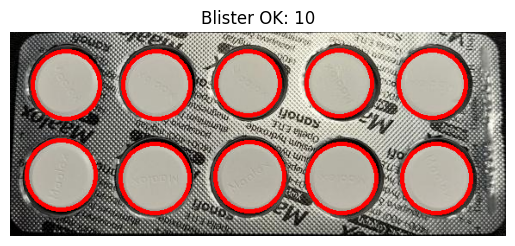


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_162205_jpg.rf.55dc24c9d9c67099904c3ca947b6584b.jpg', (640, 640, 3))
promedio: 182.0241810740192
[176 180 179 178 182 182 184 183 187 185]


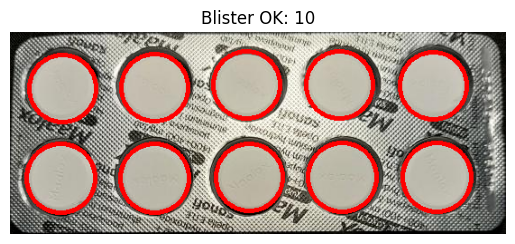


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_163018_jpg.rf.072156abdc74665ab231a0de0c39ec4a.jpg', (640, 640, 3))
promedio: 196.14418900577553
[193 188 197 194 198 193 197 198 199 200]


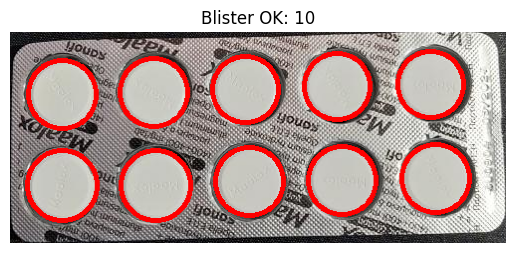


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_163348_jpg.rf.be5b44247aeb54dd8211edc21fb67aae.jpg', (640, 640, 3))
promedio: 189.80289678397926
[193 190 193 193 180 192 191 192 188 182]


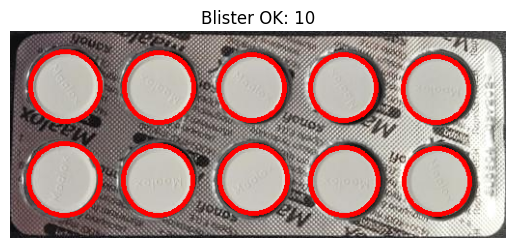


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_163425_jpg.rf.ef59285acea1a0fd6ee263c20b9022c9.jpg', (640, 640, 3))
promedio: 179.656815620064
[176 180 183 176 172 180 182 185 185 172]


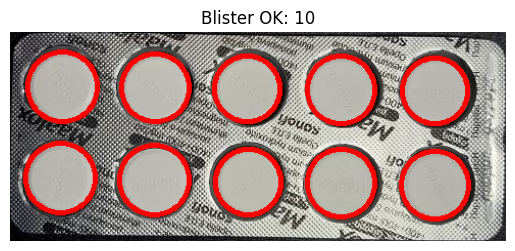


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_163601_jpg.rf.47d7c720417bbe8324321e4e47ed09ee.jpg', (640, 640, 3))
promedio: 185.6484927352265
[189 192 188 180 178 188 188 189 184 175]


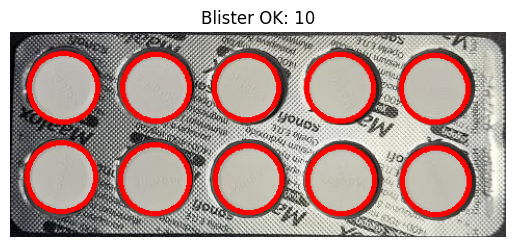


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_163622_jpg.rf.80a0a76d386947ab948ae1b7b3e65ea5.jpg', (640, 640, 3))
promedio: 190.47467959223928
[189 191 189 191 196 181 190 188 191 194]


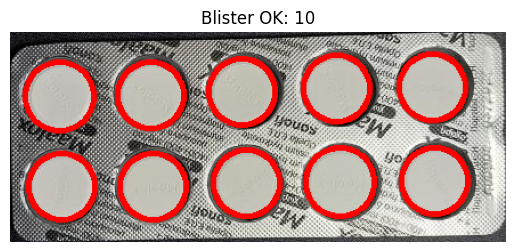


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_163623_jpg.rf.dd776684eff28cb87a62483195eed2c4.jpg', (640, 640, 3))
promedio: 188.4881472921607
[189 183 188 187 192 180 192 189 190 190]


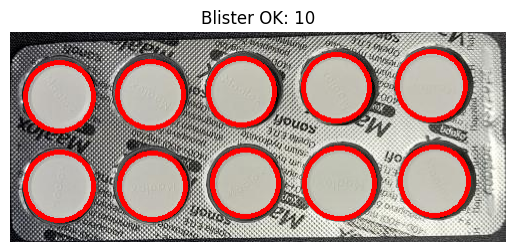


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_163630_jpg.rf.6c7a9ed1d9c08768d7082676ff0a11ba.jpg', (640, 640, 3))
promedio: 210.22589784383928
[217 215 213 205 203 212 217 214 209 192]


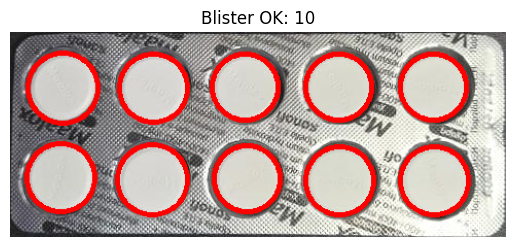


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_163630_jpg.rf.c4cd49d3a523bde6ea430037ecf3c486.jpg', (640, 640, 3))
promedio: 210.22589784383928
[217 215 213 205 203 212 217 214 209 192]


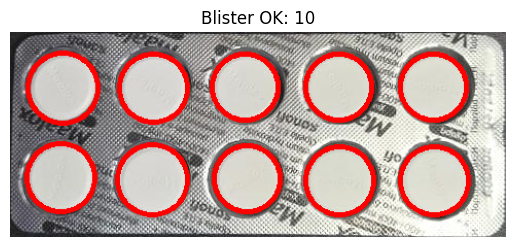


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_163717_jpg.rf.479e9666066781ae35eaf5e986122334.jpg', (640, 640, 3))
promedio: 197.21317999663256
[202 200 198 194 192 197 199 198 193 194]


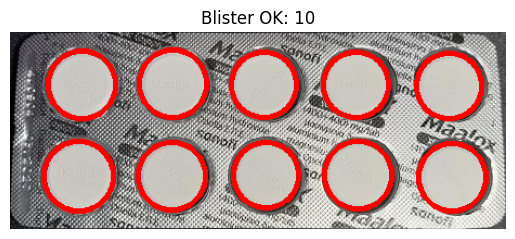


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_163759_jpg.rf.b68e618a90cc046b9f46e793bb60419d.jpg', (640, 640, 3))
promedio: 192.79143176517016
[187 197 193 183 197 194 195 195 193 189]


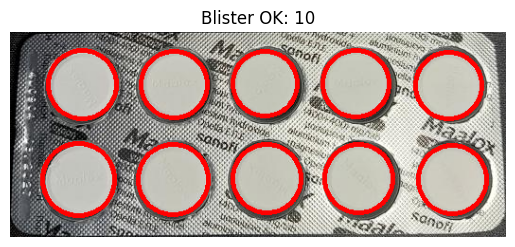


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_164025_jpg.rf.03289b44303b633c5ad34a4badafa900.jpg', (640, 640, 3))
promedio: 181.83816799347224
[182 184 183 178 176 181 182 184 185 178]


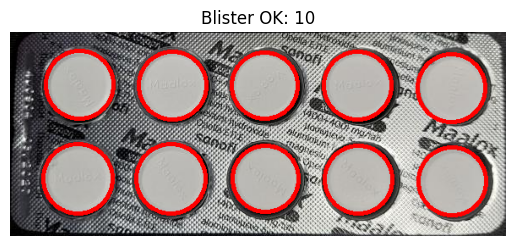


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_164357_jpg.rf.d5431377c514e1fd4735aa85d9ea7d63.jpg', (640, 640, 3))
promedio: 198.06869009116866
[200 201 201 198 186 197 203 202 197 191]


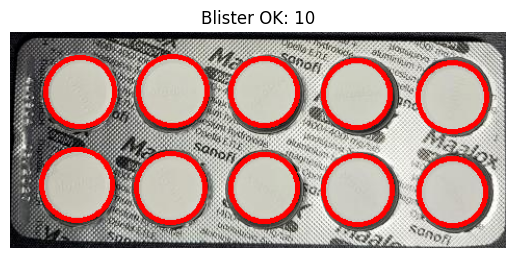


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_164729_jpg.rf.99ca294a4a7ad22ae487ca6fc3293dc5.jpg', (640, 640, 3))
promedio: 201.59408011343493
[206 205 204 201 197 200 203 200 199 197]


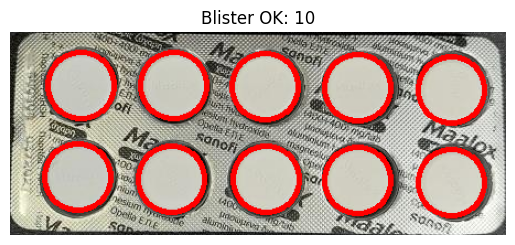


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_164755_jpg.rf.fdd8003ca31775d4ed30584e92e57527.jpg', (640, 640, 3))
promedio: 194.75529644067223
[195 191 195 191 194 194 197 192 196 197]


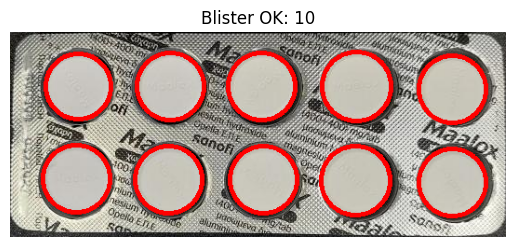


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_164757_jpg.rf.e318a5947754916d5118657478bf443d.jpg', (640, 640, 3))
promedio: 194.03450482764418
[195 193 195 192 192 192 194 194 193 195]


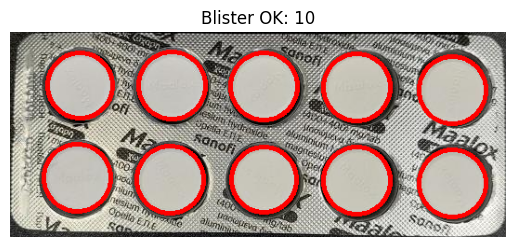


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_164800_jpg.rf.71c40bc2fbcccf0b280d683a822ed0e8.jpg', (640, 640, 3))
promedio: 197.30492809891575
[200 193 198 197 196 195 197 198 198 196]


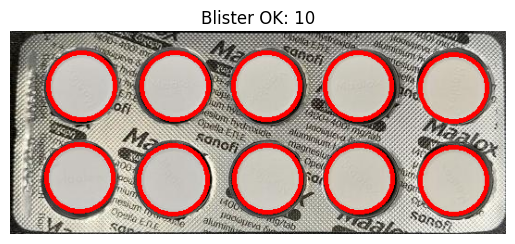


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_164807_jpg.rf.5ca80fd5be48af123a470c53e00f3e30.jpg', (640, 640, 3))
promedio: 202.12685730086525
[203 203 202 202 205 200 197 199 204 201]


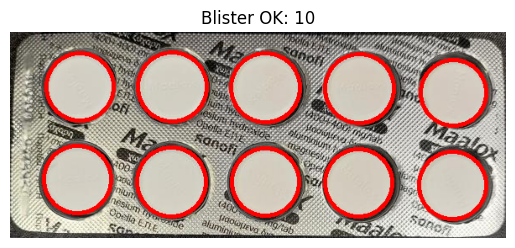


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_164816_jpg.rf.3b3f7d599d7bdda0732683ad4554853c.jpg', (640, 640, 3))
promedio: 196.57354859887778
[197 197 198 193 195 198 195 195 197 195]


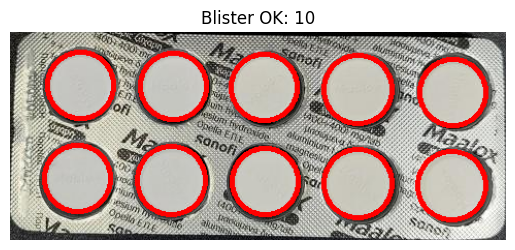


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_164819_jpg.rf.f8a65c56c7214aa36145a7ff84b77100.jpg', (640, 640, 3))
promedio: 200.0098383842512
[202 202 203 200 193 202 198 199 200 196]


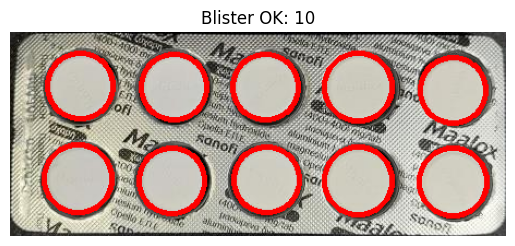


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_164823_jpg.rf.309662d6cd0e8302d3c6562d527b4353.jpg', (640, 640, 3))
promedio: 195.9052695759899
[193 194 198 195 196 194 196 195 198 196]


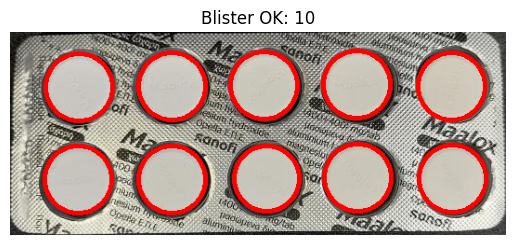


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250224_165021_jpg.rf.048d642ae1394dade8f11880b7cfeb56.jpg', (640, 640, 3))
promedio: 196.63118070461275
[192 196 196 196 199 194 195 199 196 198]


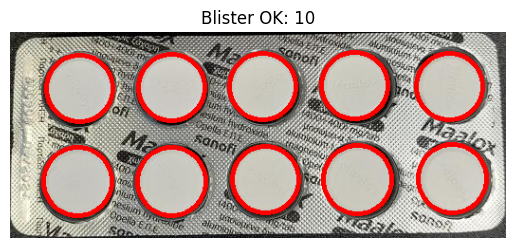


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250225_150119_jpg.rf.828ba3e2d817fa8285164929c8b94e07.jpg', (640, 640, 3))
promedio: 184.56797342617722
[178 185 179 179 186 187 186 187 185 189]


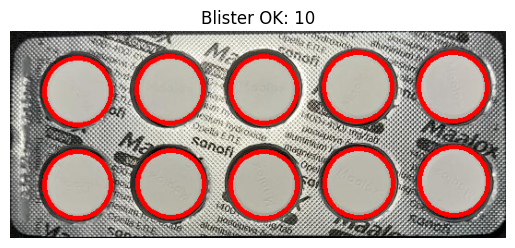


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250225_150124_jpg.rf.b593f1d9a18ed31fcec4b1b2526e6d95.jpg', (640, 640, 3))
promedio: 177.24053924929075
[171 172 173 171 174 182 178 178 183 185]


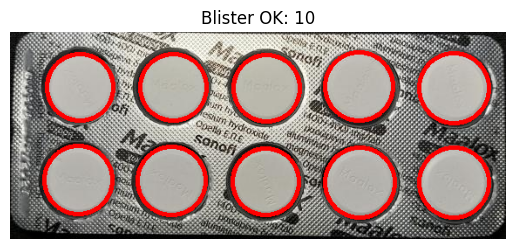


Cavidades vacías reales: 0, detectadas: 0
Detección correcta ✅

Procesada imagen: ('20250225_150913_jpg.rf.735d2986074d8cbd6784dac70928c09f.jpg', (640, 640, 3))
promedio: 170.83794613660717
[168 170 167 169 171 171 174 171 173]


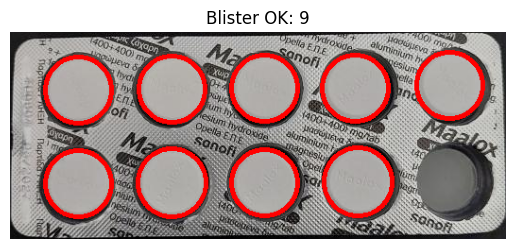


Cavidades vacías reales: 1, detectadas: 1
Detección correcta ✅

Procesada imagen: ('20250225_150948_jpg.rf.471053297abfa0e6962fc533e7c3eb6f.jpg', (640, 640, 3))
promedio: 197.61717352737378
[190 196 196 196 199 199 200 200]


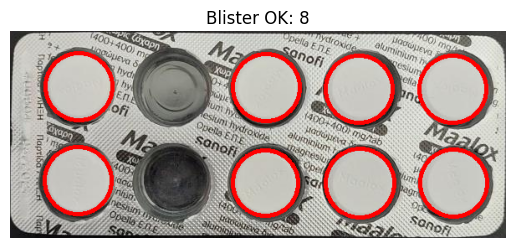


Cavidades vacías reales: 2, detectadas: 2
Detección correcta ✅

Procesada imagen: ('20250225_150956_jpg.rf.c120be6fdacd920f7b8ff0be4f6c83ed.jpg', (640, 640, 3))
promedio: 181.83867440555463
[197 197 190 199  60 196 199 201 193]


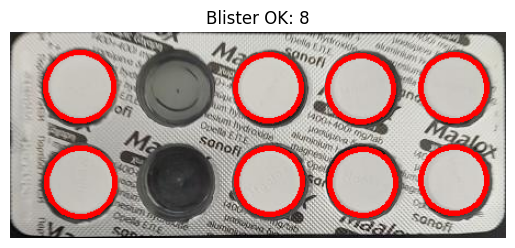


Cavidades vacías reales: 2, detectadas: 2
Detección correcta ✅

Procesada imagen: ('20250225_151103_jpg.rf.46f3abe0cb9f01b41428cfce36f545c1.jpg', (640, 640, 3))
promedio: 215.81658156214624
[217 211 212 217 218 214 218]


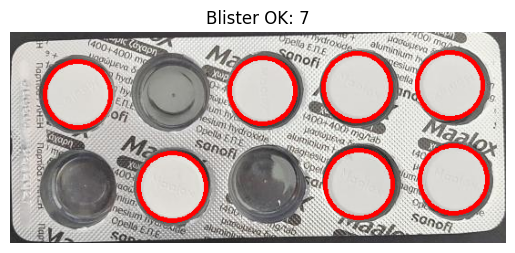


Cavidades vacías reales: 3, detectadas: 3
Detección correcta ✅

Procesada imagen: ('20250225_151103_jpg.rf.a7304fa06ec2b1297429d20f7d95062e.jpg', (640, 640, 3))
promedio: 182.71552747203674
[184 178 179 184 185 181 185]


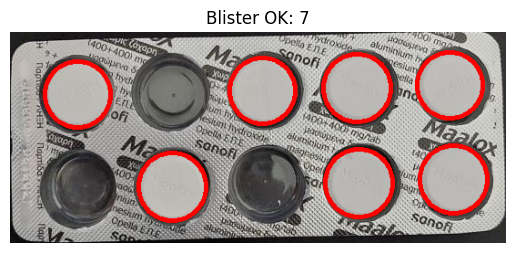


Cavidades vacías reales: 3, detectadas: 3
Detección correcta ✅

Procesada imagen: ('20250225_151137_jpg.rf.1c571d7f6c45c58fc48d196b5f8c056b.jpg', (640, 640, 3))
promedio: 210.88210518082815
[223 225 226 221 223 155 151 229 223 229]


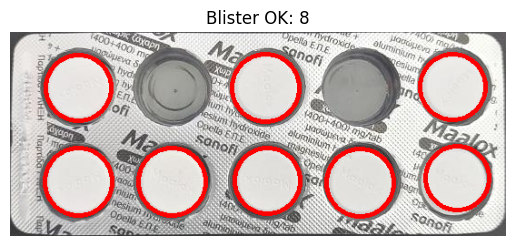


Cavidades vacías reales: 2, detectadas: 2
Detección correcta ✅

Procesada imagen: ('20250225_151139_jpg.rf.c95cb5a6d7aa80839538dd151dea63e4.jpg', (640, 640, 3))
promedio: 184.34404085555104
[193 188 190 190 189 120 193 195 196]


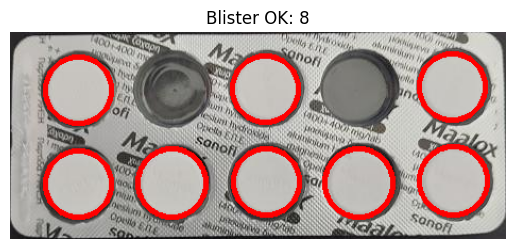


Cavidades vacías reales: 2, detectadas: 2
Detección correcta ✅

Procesada imagen: ('20250225_151217_jpg.rf.0680d2826f9d9d4199e3f17d6d759909.jpg', (640, 640, 3))
promedio: 143.91027222906146
[156 153 159  44 157 156 153 157 155]


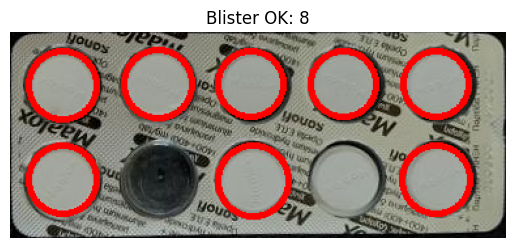


Cavidades vacías reales: 1, detectadas: 2
Detección incorrecta ❌

Procesada imagen: ('20250225_151245_jpg.rf.83267c2741ec28018396ec35f5f9e2f3.jpg', (640, 640, 3))
promedio: 182.1616509485822
[205 204 198 121 197 199 197 195 120]


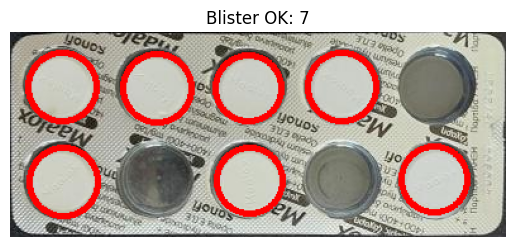


Cavidades vacías reales: 3, detectadas: 3
Detección correcta ✅

Procesada imagen: ('20250225_151254_jpg.rf.0e7bcfc8052168143bd6572657baaf1a.jpg', (640, 640, 3))
promedio: 187.47343539137478
[201 199 197 198 195 192 120 194]


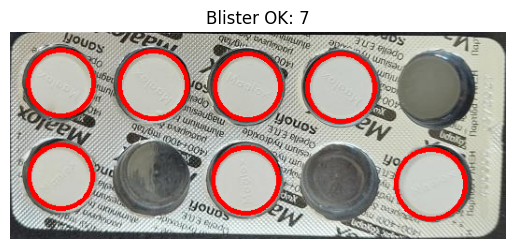


Cavidades vacías reales: 3, detectadas: 3
Detección correcta ✅

Procesada imagen: ('20250225_151314_jpg.rf.4e652ec8f7c0f7de46f86140ceec4e88.jpg', (640, 640, 3))
promedio: 140.58594998276493
[154 158 154 155 156 157 152  14 152 149]


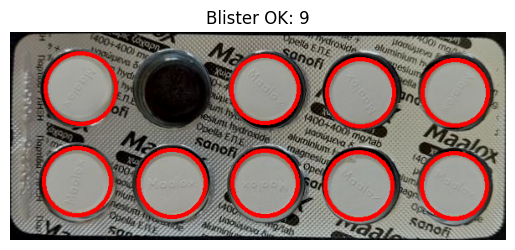


Cavidades vacías reales: 1, detectadas: 1
Detección correcta ✅

Procesada imagen: ('20250225_151540_jpg.rf.4a61307bacfb8f380afb439a4df38ca1.jpg', (640, 640, 3))
promedio: 178.03747777693673
[171 175 169 167 170 191 185 187 184]


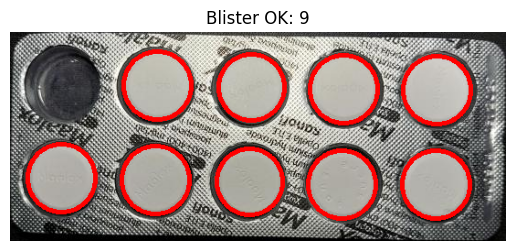


Cavidades vacías reales: 1, detectadas: 1
Detección correcta ✅

Procesada imagen: ('20250225_151543_jpg.rf.709b0ce931a67fb1eefae042b38697d1.jpg', (640, 640, 3))
promedio: 184.5562604639403
[181 178 176 177 172 194 195 194 188]


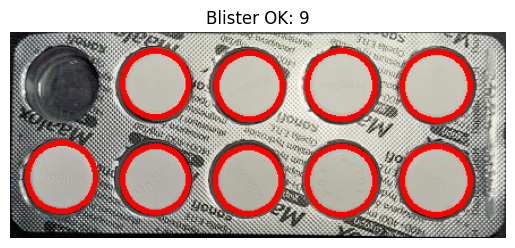


Procesada imagen: ('20250225_151859_jpg.rf.062436a1768689c95e016f40c2dd50a8.jpg', (640, 640, 3))
promedio: 223.38096756987127
[221 214 223 213 240 232 218]


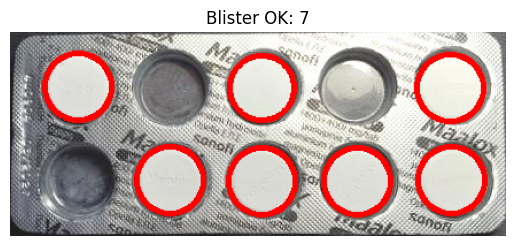


Cavidades vacías reales: 3, detectadas: 3
Detección correcta ✅

Procesada imagen: ('20250225_152024_jpg.rf.1ae8e1766afef1286f443e0868ba6c23.jpg', (640, 640, 3))
promedio: 190.61981311726797
[183 182 173 198 201 201 194]


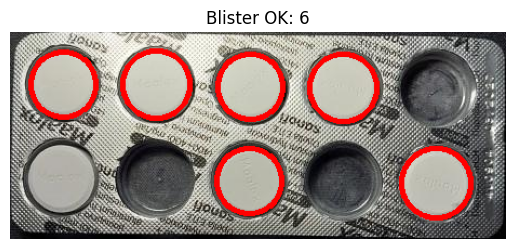


Cavidades vacías reales: 3, detectadas: 4
Detección incorrecta ❌

Procesada imagen: ('20250225_154108_jpg.rf.fd0abdd51d8af90df75d79419f96d5f5.jpg', (640, 640, 3))
promedio: 181.94444013218444
[179 183 182 180 182 182 183 179 183]


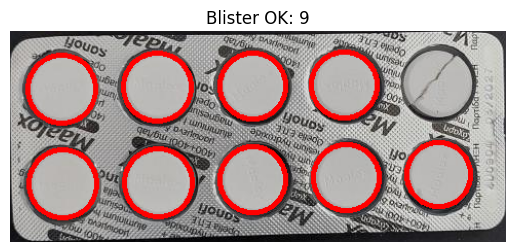


Cavidades vacías reales: 1, detectadas: 1
Detección correcta ✅

Procesada imagen: ('20250225_154112_jpg.rf.12744b95534d43330cde2165ffa20e76.jpg', (640, 640, 3))
promedio: 183.1943261903071
[182 181 184 179 182 183 183 184 185]


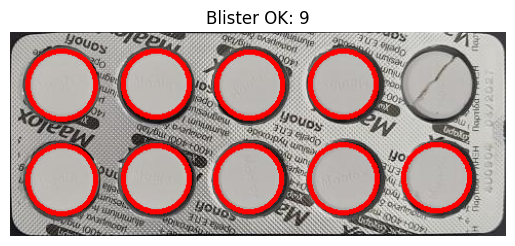


Cavidades vacías reales: 1, detectadas: 1
Detección correcta ✅

Procesada imagen: ('20250225_154404_jpg.rf.494a7871e901083dbcb8b7393a4711be.jpg', (640, 640, 3))
promedio: 181.21063921987272
[178 178 179 180 180 183 183 182 183]


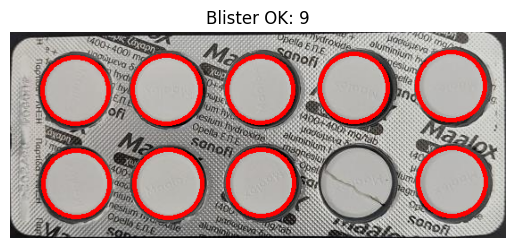


Cavidades vacías reales: 1, detectadas: 1
Detección correcta ✅

Procesada imagen: ('20250225_154528_jpg.rf.371f38e4c0a2aff26016b3427ddb0b25.jpg', (640, 640, 3))
promedio: 188.91518071117767
[188 185 189 185 190 191 191 187]


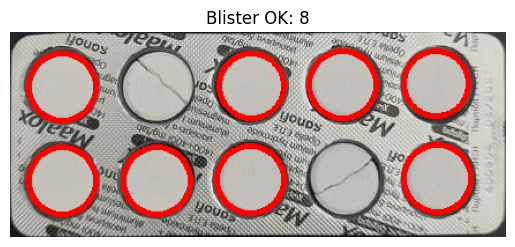


Cavidades vacías reales: 2, detectadas: 2
Detección correcta ✅

Procesada imagen: ('20250225_161141_jpg.rf.5574a442c3ae9aab79708b27b7541948.jpg', (640, 640, 3))
promedio: 190.6867700434399
[188 189 189 189 191 192 191 192 191]


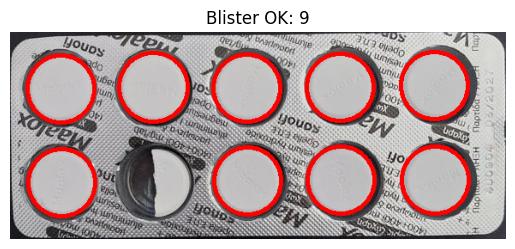


Cavidades vacías reales: 1, detectadas: 1
Detección correcta ✅

Procesada imagen: ('20250225_161304_jpg.rf.b57658709e5902fd290411fbad65657d.jpg', (640, 640, 3))
promedio: 183.72748419742723
[179 179 181 179 188 185 186 183 190]


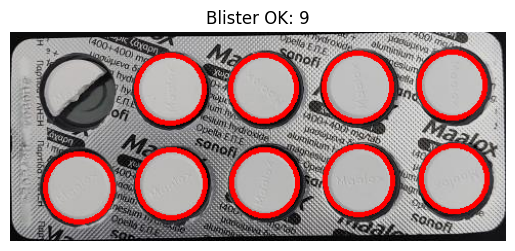


Cavidades vacías reales: 1, detectadas: 1
Detección correcta ✅

Procesada imagen: ('20250225_161552_jpg.rf.9ba490255f38f38e31a0524862161563.jpg', (640, 640, 3))
promedio: 173.43389403335328
[166 173 175 174 171 174 175 177]


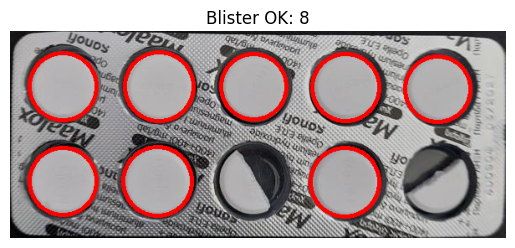


Cavidades vacías reales: 2, detectadas: 2
Detección correcta ✅

Procesada imagen: ('20250225_164532_jpg.rf.61ffd46aaa9573294494a0b18fc54a66.jpg', (640, 640, 3))
promedio: 177.90867273234346
[171 173 173 174 183 184 182 180]


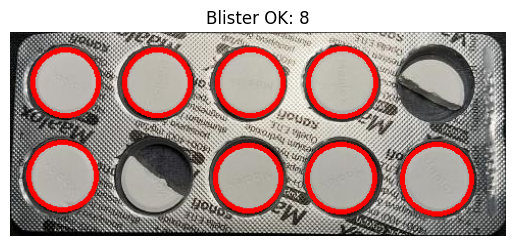


Cavidades vacías reales: 2, detectadas: 2
Detección correcta ✅

Procesada imagen: ('20250225_165624_jpg.rf.1e4a8832a7e0f141efad97260b9c732d.jpg', (640, 640, 3))
promedio: 173.30124085973853
[173 163 164 180 183 172 168 178]


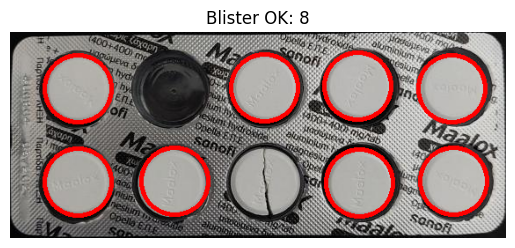


Cavidades vacías reales: 2, detectadas: 2
Detección correcta ✅

Procesada imagen: ('20250225_165928_jpg.rf.90f291475d3fe4f2009933e1191bdb6e.jpg', (640, 640, 3))
promedio: 176.8117025558829
[168 182 168 179 171 185 183 174]


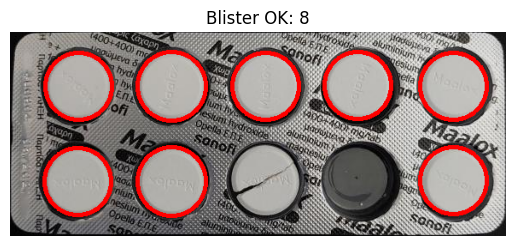


Cavidades vacías reales: 2, detectadas: 2
Detección correcta ✅

Procesada imagen: ('20250225_170045_jpg.rf.b1e64bd64417c5964042f2958d2c4eff.jpg', (640, 640, 3))
promedio: 152.46280255655768
[168  66 158 158 151 168 170 168 161]


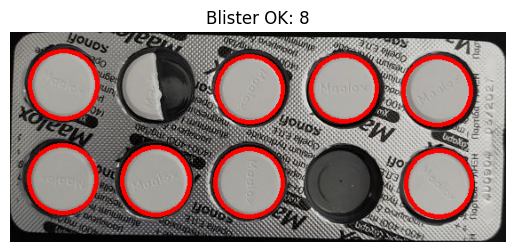


Cavidades vacías reales: 2, detectadas: 2
Detección correcta ✅

Procesada imagen: ('20250225_170053_jpg.rf.dcbb4f70eff7f4529a2b7b8a1e8445c5.jpg', (640, 640, 3))
promedio: 176.04887619475875
[184 172 168 171 183 181 177 169]


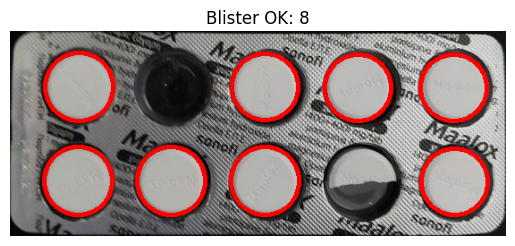


Cavidades vacías reales: 2, detectadas: 2
Detección correcta ✅

Procesada imagen: ('20250225_170111_jpg.rf.97d8a1e20025d109dc89e6a0659353e1.jpg', (640, 640, 3))
promedio: 161.5038308815236
[ 74 170 167 167 181 181 177 171]


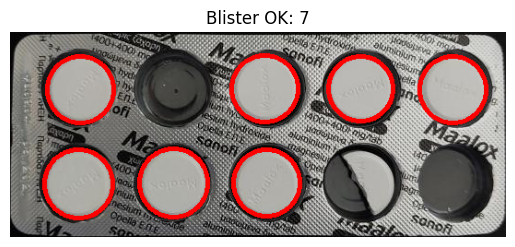


Cavidades vacías reales: 3, detectadas: 3
Detección correcta ✅

Procesada imagen: ('20250225_170526_jpg.rf.003ebc0d88afd130afb3385ee759fcca.jpg', (640, 640, 3))
promedio: 180.81588875433445
[191 190 107 188 193 199 195]


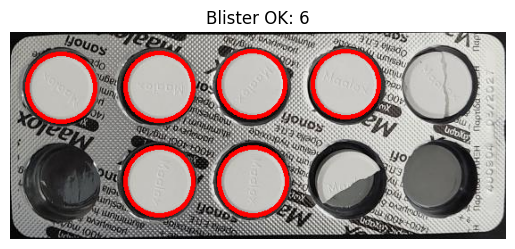


Cavidades vacías reales: 4, detectadas: 4
Detección correcta ✅

Procesada imagen: ('20250225_170642_jpg.rf.679b22da021ece3d786c4781cb4f8cb4.jpg', (640, 640, 3))
promedio: 168.60103862253814
[164 161 175 174 164 170]


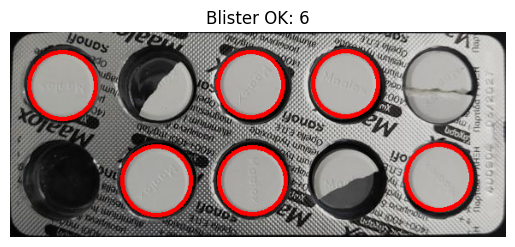


Cavidades vacías reales: 4, detectadas: 4
Detección correcta ✅

Procesada imagen: ('20250225_171024_jpg.rf.97c270f659864f7acb5568b7ae2f068b.jpg', (640, 640, 3))
promedio: 198.9265793963161
[192 194 198 203 201 203]


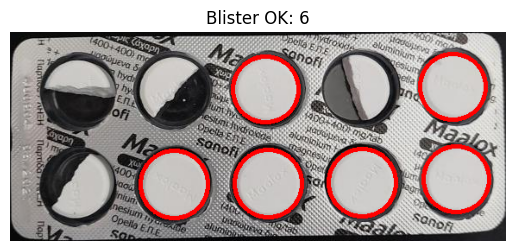


Cavidades vacías reales: 4, detectadas: 4
Detección correcta ✅

Procesada imagen: ('20250225_171657_jpg.rf.42b689580e5dd270e391c45293083ab7.jpg', (640, 640, 3))
promedio: 158.25508920380466
[145 163 171 156 151 162 157]


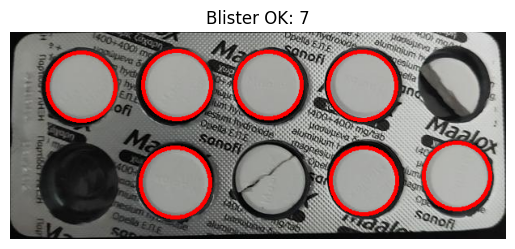


Cavidades vacías reales: 3, detectadas: 3
Detección correcta ✅

Procesada imagen: ('20250225_171725_jpg.rf.9030d574488045eedb55112192a56bb2.jpg', (640, 640, 3))
promedio: 151.35432816180315
[148 156  67 176 155 158 171 177]


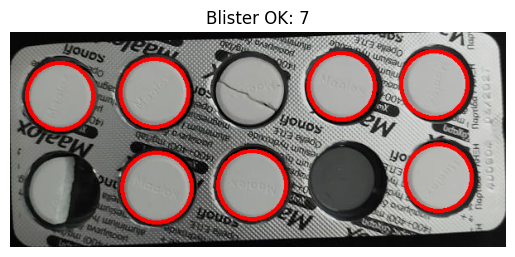


Cavidades vacías reales: 3, detectadas: 3
Detección correcta ✅

Procesada imagen: ('20250225_171734_jpg.rf.7a448fb806ae22762e1fa55a4b515633.jpg', (640, 640, 3))
promedio: 130.6999193116214
[144 150 167  62  41 163 162 152]


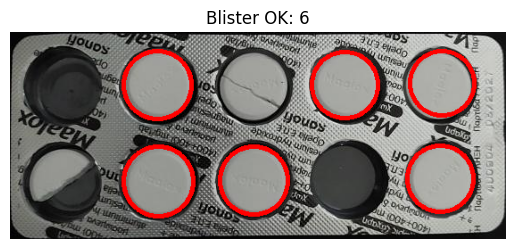


Cavidades vacías reales: 4, detectadas: 4
Detección correcta ✅

Procesada imagen: ('20250225_171749_jpg.rf.bcfeef21f8c4e541914265f8faf79fb2.jpg', (640, 640, 3))
promedio: 188.02533370814535
[202 101 201 201 203 203 201]


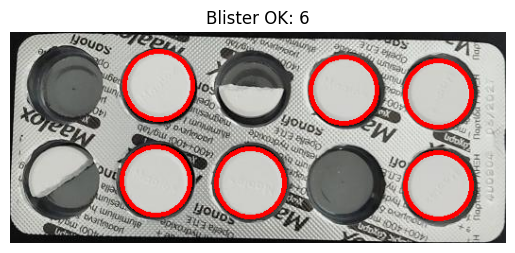


Cavidades vacías reales: 4, detectadas: 4
Detección correcta ✅

Procesada imagen: ('20250225_171805_jpg.rf.3e4e56eb7116a5bccfa145fe4c74a3ab.jpg', (640, 640, 3))
promedio: 122.6099239464538
[152 154  62 167  55 158 167  61]


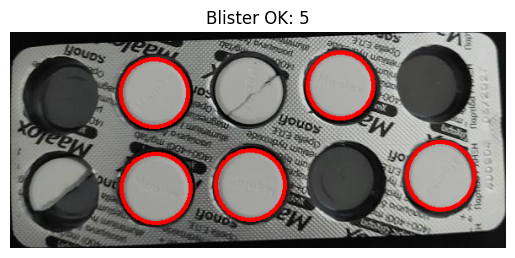


Cavidades vacías reales: 5, detectadas: 5
Detección correcta ✅

Procesada imagen: ('20250225_171848_jpg.rf.a63d395f50938a9019e634b1e15b15a1.jpg', (640, 640, 3))
promedio: 176.22586107897493
[186  93 199 187 193 196]


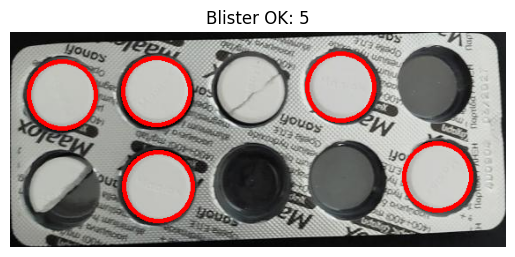


Cavidades vacías reales: 5, detectadas: 5
Detección correcta ✅

Procesada imagen: ('20250312_165803_jpg.rf.b23627621808796f3a5768fa962a831f.jpg', (640, 640, 3))
promedio: 192.89987685496294
[194 191 195 193 191 193 192 191]


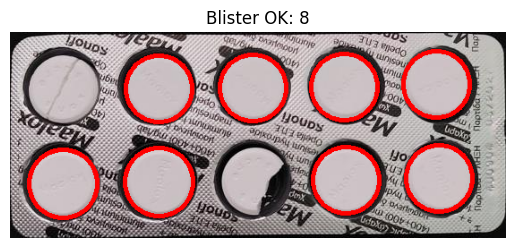


Cavidades vacías reales: 2, detectadas: 2
Detección correcta ✅

Procesada imagen: ('20250312_171405_jpg.rf.f9912a7abc226718ea46235a99d1f1b4.jpg', (640, 640, 3))
promedio: 146.2418207636835
[165 172  35 175 164 164]


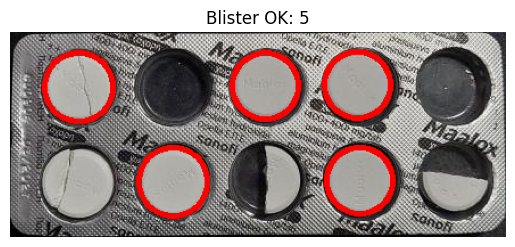


Cavidades vacías reales: 5, detectadas: 5
Detección correcta ✅

Procesada imagen: ('20250312_171509_jpg.rf.eeb91672439923aff235e176cd1e026f.jpg', (640, 640, 3))
promedio: 165.36216711443475
[169 170 154 167]


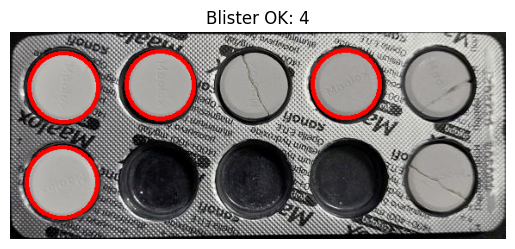


Cavidades vacías reales: 6, detectadas: 6
Detección correcta ✅

Procesada imagen: ('20250312_171529_jpg.rf.8e9d3150799d6e5e0a6ceed59bc58a84.jpg', (640, 640, 3))
promedio: 166.93368877040987
[170 172 166 157]


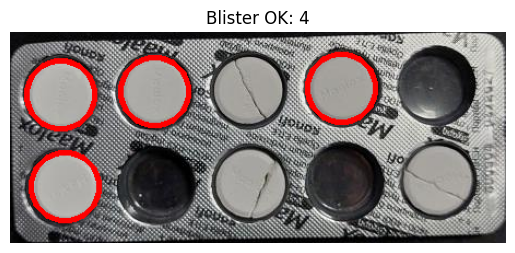


Cavidades vacías reales: 6, detectadas: 6
Detección correcta ✅

Procesada imagen: ('20250312_171539_jpg.rf.1add4b5396aba0cecf9e72546887c1aa.jpg', (640, 640, 3))
promedio: 184.97293085012126
[190 182 186 180 185]


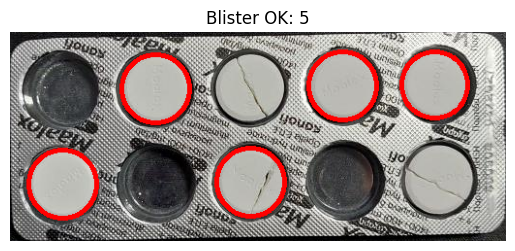


Cavidades vacías reales: 5, detectadas: 5
Detección correcta ✅

Procesada imagen: ('20250312_171642_jpg.rf.385bb55d9b323381cd7ff62d30d99092.jpg', (640, 640, 3))
promedio: 167.62630852874344
[170 165 162 171]


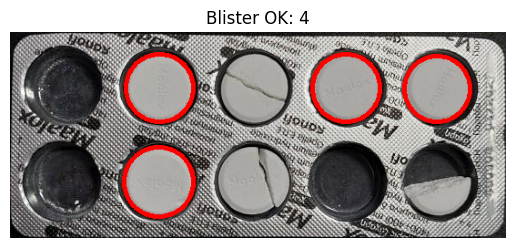


Cavidades vacías reales: 6, detectadas: 6
Detección correcta ✅

Procesada imagen: ('20250312_171700_jpg.rf.3c726cccd70bddc558b2b278c5bd284c.jpg', (640, 640, 3))
promedio: 190.35936440693666
[192 188 191 189]


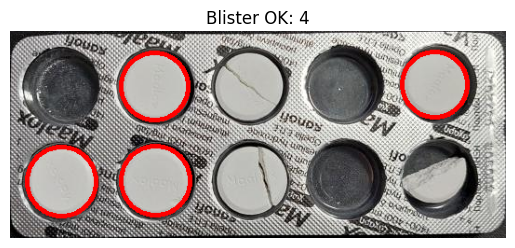


Cavidades vacías reales: 6, detectadas: 6
Detección correcta ✅

Procesada imagen: ('20250312_171824_jpg.rf.1134a98874918268298d8871aa33588a.jpg', (640, 640, 3))
promedio: 191.92622631715545
[193 189 194 190]


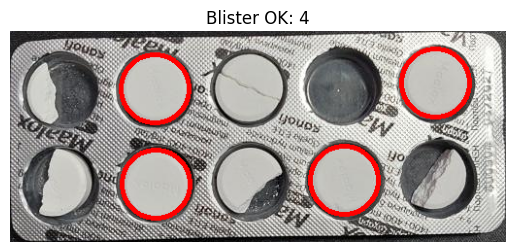


Cavidades vacías reales: 6, detectadas: 6
Detección correcta ✅

Procesada imagen: ('20250312_172022_jpg.rf.2c3f0762f8e452abc9a26f1461adcdce.jpg', (640, 640, 3))
promedio: 152.03313128796867
[177 176 175 173  57]


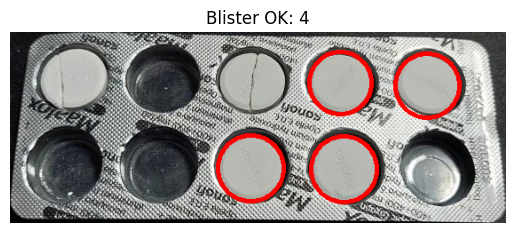


Cavidades vacías reales: 6, detectadas: 6
Detección correcta ✅

Procesada imagen: ('20250312_172359_jpg.rf.60234149154ea84176086082f3682819.jpg', (640, 640, 3))
promedio: 192.02638937357753
[188 190 191 190 198]


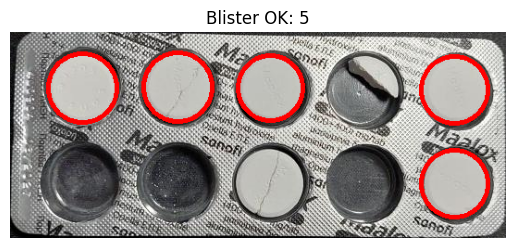


Cavidades vacías reales: 5, detectadas: 5
Detección correcta ✅

Procesada imagen: ('20250312_172712_jpg.rf.21380d295220517e61e78e18e8b2ab18.jpg', (640, 640, 3))
promedio: 192.05114950215483
[189 188 195 194]


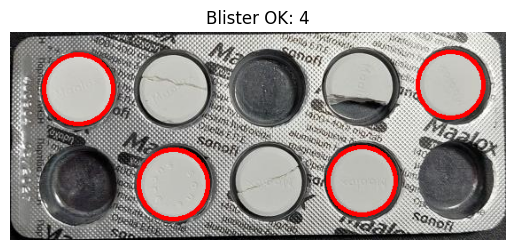


Cavidades vacías reales: 6, detectadas: 6
Detección correcta ✅

Procesada imagen: ('20250312_173113_jpg.rf.6eb41a18735d11eb5db67be57a921f32.jpg', (640, 640, 3))
promedio: 171.73703106163774
[166 176 167 164 173 181]


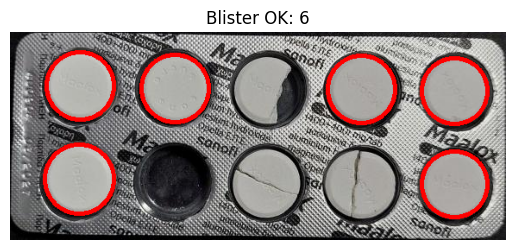


Cavidades vacías reales: 4, detectadas: 4
Detección correcta ✅

Procesada imagen: ('20250312_173454_jpg.rf.d260cc844542c7f0e853c212cc66fcfb.jpg', (640, 640, 3))
promedio: 170.72053198867476
[157 169 171 174 180]


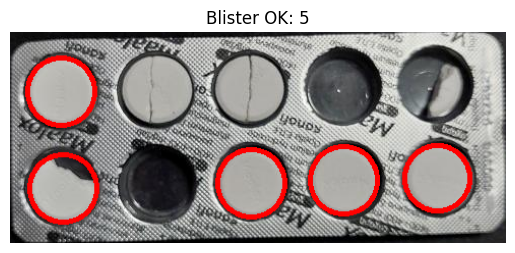


Cavidades vacías reales: 5, detectadas: 5
Detección correcta ✅

Procesada imagen: ('20250312_173631_jpg.rf.7c0f651e5b870507a6bb587e70c89a22.jpg', (640, 640, 3))
promedio: 165.09882398847293
[169 162 159 168]


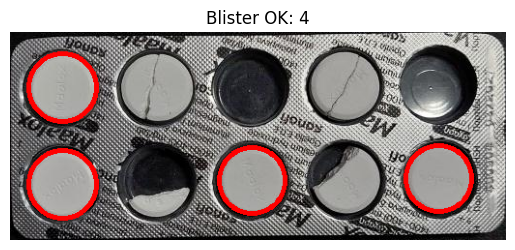


Cavidades vacías reales: 6, detectadas: 6
Detección correcta ✅

Procesada imagen: ('20250312_173711_jpg.rf.1573423577f218f012d5df2c93997d9c.jpg', (640, 640, 3))
promedio: 169.56299898591914
[169 164 174 173 165]


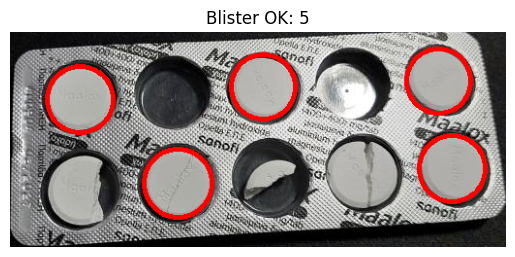


Cavidades vacías reales: 5, detectadas: 5
Detección correcta ✅

Procesada imagen: ('20250312_173844_jpg.rf.e0363150be9ff3d434ab98ac8774b22b.jpg', (640, 640, 3))
promedio: 160.93125817407082
[159 165 158 153 170 158 161]


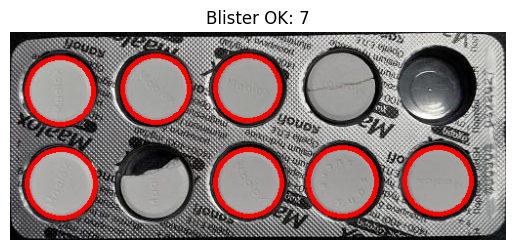


Cavidades vacías reales: 3, detectadas: 3
Detección correcta ✅

Procesada imagen: ('20250312_173916_jpg.rf.385f793dab7e08b0c6124c6aeb99d0be.jpg', (640, 640, 3))
promedio: 161.67755478191347
[156 159 170 166 157 159]


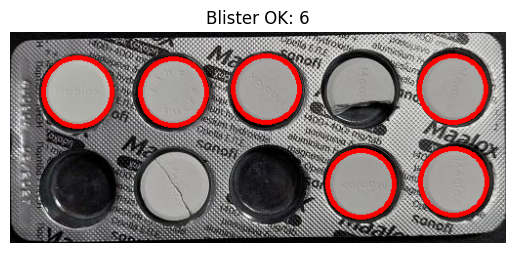


Cavidades vacías reales: 4, detectadas: 4
Detección correcta ✅

Procesada imagen: ('20250312_173925_jpg.rf.b50ba8fa6b978d59365b5b4590a8abc1.jpg', (640, 640, 3))
promedio: 184.7576164837499
[184 183 186 184 184]


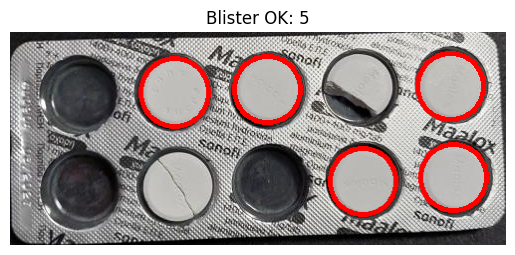


Cavidades vacías reales: 5, detectadas: 5
Detección correcta ✅
Imágenes procesadas: 100, detecciones correctas: 96, precisión: 96.00%


In [114]:
image_folder = "img_depurado/"
for filename in os.listdir(image_folder):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        procesados += 1
        image_path = os.path.join(image_folder, filename) #ruta completa
        img = cv2.imread(image_path) #cargar imagen
        blister_contour = find_blister_contour(img)
        img_contour = img.copy()
        print(f"\nProcesada imagen: {filename, img_contour.shape}")
        blister = recortar_blister(img_contour, blister_contour)
        img_circles, blister_ok, niveles,cavidades = detectar_cavidades_contornos(blister,min_area=1000, circularity_thresh=(0.8, 1.1))
      
        plt.imshow(cv2.cvtColor(img_circles, cv2.COLOR_BGR2RGB))
        plt.axis('off')  # Ocultar los ejes
        plt.title(f"Blister OK: {blister_ok}")
        plt.show()

        # Comparación con reales
        vacias_reales = reales.get(filename, None)

        if vacias_reales is not None:
            vacias_detectadas = total_cavidades - blister_ok
            print(f"\nCavidades vacías reales: {vacias_reales}, detectadas: {vacias_detectadas}")

            if vacias_reales == vacias_detectadas:
                correctos += 1
                print("Detección correcta ✅")
            else:
                print("Detección incorrecta ❌")


print(f"Imágenes procesadas: {procesados}, detecciones correctas: {correctos}, precisión: {(correctos/procesados)*100:.2f}%")
